In [1]:
import math
import numpy as np
import sys
import os
import uproot
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm
from scipy import stats, optimize
import pylandau
from pathlib import Path



findfont: Font family ['Bitstream Vera Sans'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Bitstream Vera Sans'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Bitstream Vera Sans'] not found. Falling back to DejaVu Sans.


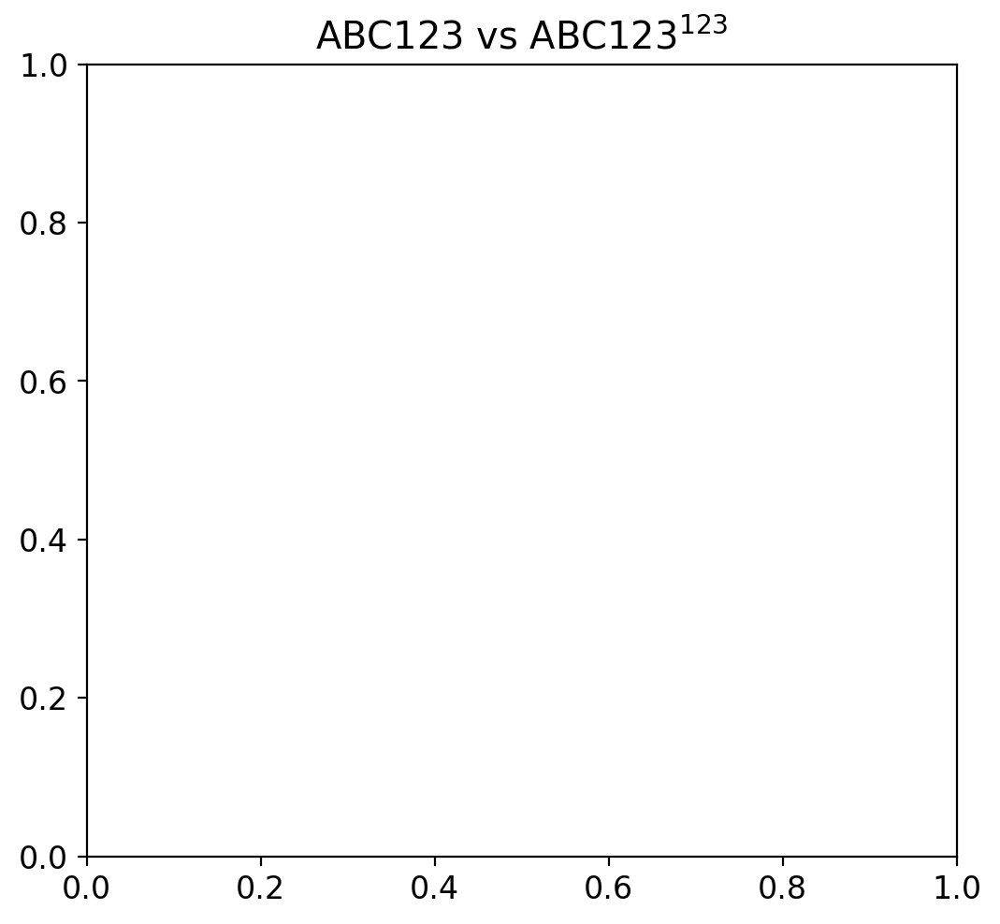

In [2]:
from CRVclasses import *

In [3]:
# from funs import *

plt.rcParams["font.size"]=12
plt.rcParams["axes.labelsize"]=12
plt.rcParams["figure.dpi"]=200
plt.rcParams['figure.figsize'] = [6, 5.5]

In [4]:
%%capture

matplotlib.rcParams['mathtext.fontset'] = 'custom'
matplotlib.rcParams['mathtext.rm'] = 'Bitstream Vera Sans'
matplotlib.rcParams['mathtext.it'] = 'Bitstream Vera Sans:italic'
matplotlib.rcParams['mathtext.bf'] = 'Bitstream Vera Sans:bold'
matplotlib.pyplot.title(r'ABC123 vs $\mathrm{ABC123}^{123}$')

matplotlib.rcParams['mathtext.fontset'] = 'stix'
matplotlib.rcParams['font.family'] = 'STIXGeneral'
matplotlib.pyplot.title(r'ABC123 vs $\mathrm{ABC123}^{123}$')

In [5]:
geo1 = ModuleGeoRect1()

Rectangular module dimensions: L = 3000, l = 1240, D = 4240


(-2200.0, 2200.0)

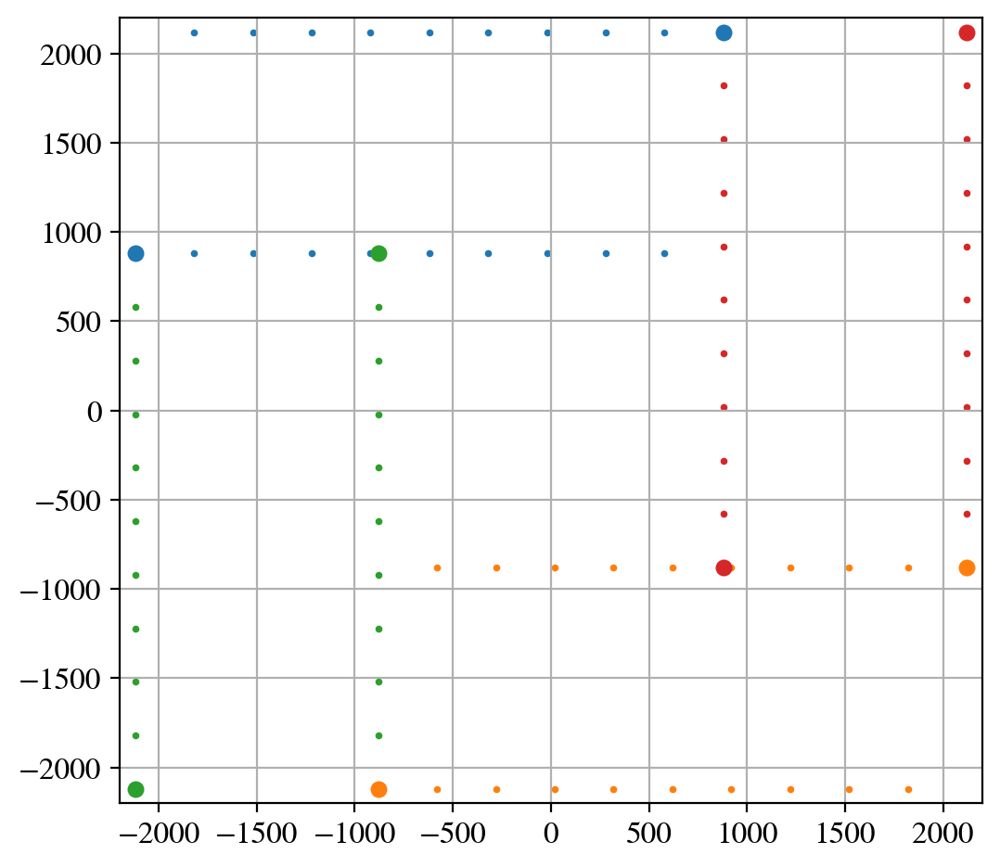

In [6]:
nstrips = 10

for i in range(nstrips):
    plt.scatter(geo1.xStripsBounds1[i], geo1.yStripsBounds1[i], s=3, c='tab:blue')
    plt.scatter(geo1.xStripsBounds2[i], geo1.yStripsBounds2[i], s=3, c='tab:green')
    plt.scatter(geo1.xStripsBounds3[i], geo1.yStripsBounds3[i], s=3, c='tab:orange')
    plt.scatter(geo1.xStripsBounds4[i], geo1.yStripsBounds4[i], s=3, c='tab:red')

plt.scatter(geo1.xBounds1, geo1.yBounds1, s=30, c='tab:blue')
plt.scatter(geo1.xBounds2, geo1.yBounds2, s=30, c='tab:green')
plt.scatter(geo1.xBounds3, geo1.yBounds3, s=30, c='tab:orange')
plt.scatter(geo1.xBounds4, geo1.yBounds4, s=30, c='tab:red')

plt.grid()
plt.xlim(-2200, 2200)
plt.ylim(-2200, 2200)

In [7]:
grid0 = ModuleGeoGrid(ngrid=50)

In [8]:
frontcrv0 = CRVHitMap("../Root_outputs/CRVAnalysis.root")

In [9]:
frontcrv0.getGeometry(geo_type='grid', nstrips=43)
frontcrv0.getHitsPerChannel()

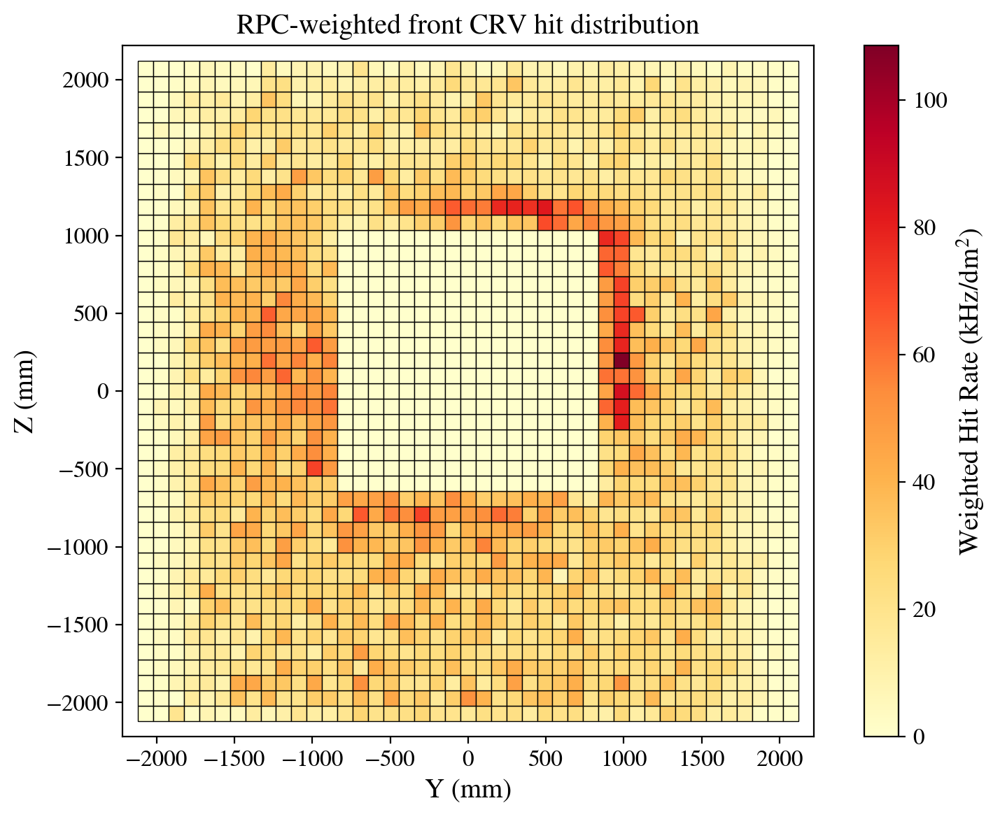

In [10]:
plot_grid_hitmap(frontcrv0, plotHits=False)

In [11]:
len(frontcrv0.treeFront_arr['PositionT'])

2319237

In [12]:
## 1 kHz/dm2 = 1000/100 Hz/cm2 = 10 Hz/cm2 

In [13]:
crvmap = frontcrv0
nbins_t, nbins_y, nbins_z = 100, 100, 100

t_data, x_data, y_data, z_data = crvmap.HitT, crvmap.HitX, crvmap.HitY, crvmap.HitZ

# 3d hist in the YZ plane
hist3d, edges = np.histogramdd(
    np.stack([t_data, y_data, z_data], axis=1),
    bins=[nbins_t, nbins_y, nbins_z],
    density=True
)

# # Flatten the histogram
pdf_flat = hist3d.flatten()
print(np.sum(pdf_flat))
pdf_flat /= np.sum(pdf_flat)  # Ensure it sums to 1

2.4014227927425715e-09


In [14]:
np.sum( hist3d.flatten())

2.4014227927425715e-09

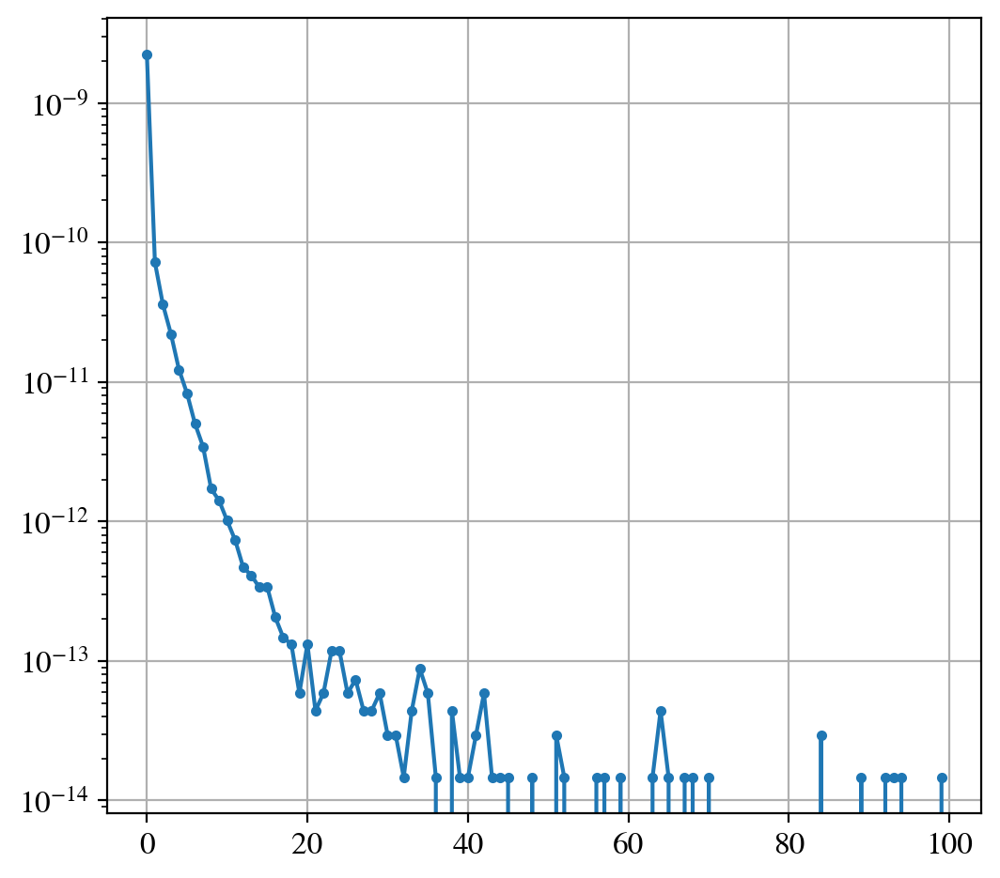

In [15]:
hist_t = hist3d.sum(axis=(1,2))
plt.plot(hist_t, '.-')
plt.grid()
plt.yscale('log')

In [16]:
# Sample from flattened histogram
N = 10000
indices = np.random.choice(len(pdf_flat), size=N, p=pdf_flat)
multi_indices = np.array(np.unravel_index(indices, hist3d.shape)).T
indices


# Convert to real values by sampling inside bins
t_bins = edges[0]
x_bins = edges[1]
y_bins = edges[2]
# z_bins = edges[3]

t_new = np.random.uniform(t_bins[multi_indices[:,0]], t_bins[multi_indices[:,0]+1])
x_new = np.random.uniform(x_bins[multi_indices[:,1]], x_bins[multi_indices[:,1]+1])
y_new = np.random.uniform(y_bins[multi_indices[:,2]], y_bins[multi_indices[:,2]+1])
# z_new = np.random.uniform(z_bins[multi_indices[:,3]], z_bins[multi_indices[:,3]+1])

synthetic_hits = np.stack([t_new, x_new, y_new], axis=1)

In [17]:
xx1 = np.random.normal(0, 1, 1000)
xx2 = np.random.normal(0, 1, 1000)

np.corrcoef(xx1, xx2)

array([[ 1.        , -0.05094078],
       [-0.05094078,  1.        ]])

In [18]:
np.corrcoef(frontcrv0.HitT, frontcrv0.HitX), np.corrcoef(frontcrv0.HitT, frontcrv0.HitY), np.corrcoef(frontcrv0.HitT, frontcrv0.HitZ)

(array([[ 1.        , -0.00787421],
        [-0.00787421,  1.        ]]),
 array([[ 1.        , -0.06577853],
        [-0.06577853,  1.        ]]),
 array([[ 1.       , -0.0587527],
        [-0.0587527,  1.       ]]))

In [19]:
np.corrcoef(frontcrv0.HitX, frontcrv0.HitY), np.corrcoef(frontcrv0.HitY, frontcrv0.HitZ), np.corrcoef(frontcrv0.HitX, frontcrv0.HitZ)

(array([[1.       , 0.0931913],
        [0.0931913, 1.       ]]),
 array([[ 1.        , -0.00666567],
        [-0.00666567,  1.        ]]),
 array([[ 1.        , -0.01687079],
        [-0.01687079,  1.        ]]))

In [20]:
np.corrcoef(frontcrv0.HitT, (frontcrv0.HitY**2 + frontcrv0.HitZ**2)**0.5)

array([[1.        , 0.09579868],
       [0.09579868, 1.        ]])

In [21]:
def xBins(bins):
    return np.array([ (bins[i]+bins[i+1])/2 for i in range(len(bins)-1) ])

def getPDFfromDist(t_arr, nbins):
    pdf_t, bins_t = np.histogram(t_arr, nbins, density=True)
    xbins_t = xBins(bins_t)
    return pdf_t, xbins_t

def invCDFGen(cdf, xbins, nsamples):
    # draw y-value from uniform distribution
    u_arr = np.random.uniform(0, 1, nsamples)
    # find cdf point index of y-value
    indices = np.searchsorted(cdf, u_arr)
    # get x-value (x_i = F-1(y_i))
    x_dist = xbins[indices]
    return x_dist

def generateFromDist(t_arr, nbins, nsamples):
    pdf_t, xbins_t = getPDFfromDist(t_arr, nbins)
    norm = np.sum(pdf_t)
    print("pdf norm = {:.2e}".format(norm))
    cdf_t = np.cumsum(pdf_t) / norm
    t_dist = invCDFGen(cdf_t, xbins_t, nsamples)
    return t_dist

def getPDFfromDist_2D(x_data, y_data, nbins):
    hist2d, x_edges, y_edges = np.histogram2d(x_data, y_data, bins=nbins, density=True)
    xbins, ybins = xBins(x_edges), xBins(y_edges)
    return hist2d, xbins, ybins

def invCDFGen_2D(cdf, tbins, sbins, nsamples, twoDshape):
    # draw y-value from uniform distribution
    u_arr = np.random.uniform(0, 1, nsamples)
    # find cdf point index of y-value
    indices = np.searchsorted(cdf, u_arr)
    # convert flat indices to 2D bin indices
    t_idx, s_idx = np.unravel_index(indices, twoDshape) 
    # get x-value (x_i = F-1(y_i))
    t_dist = tbins[t_idx]
    s_dist = sbins[s_idx]
    return t_dist, s_dist

def generateFromDist_2D(x_data, y_data, nbins, nsamples):
    hist2d, xbins, ybins = getPDFfromDist_2D(x_data, y_data, nbins)
    pdf = hist2d.flatten()
    norm = np.sum(pdf)
    print("pdf norm = {:.2e}".format(norm))
    cdf = np.cumsum(pdf) / norm
    x_dist, y_dist = invCDFGen_2D(cdf, xbins, ybins, nsamples, hist2d.shape)
    return x_dist, y_dist

def getPDFfromDist_3D(t_data, x_data, y_data, nbinst, nbinsxy):
    hist3d, edges = np.histogramdd([t_data, x_data, y_data], np.array([nbinst, nbinsxy, nbinsxy]), density=True)
    t_edges, x_edges, y_edges = edges
    tbins, xbins, ybins = xBins(t_edges), xBins(x_edges), xBins(y_edges)
    return hist3d, tbins, xbins, ybins

def invCDFGen_3D(cdf, tbins, sbins, rbins, nsamples, twoDshape):
    # draw y-value from uniform distribution
    u_arr = np.random.uniform(0, 1, nsamples)
    # find cdf point index of y-value
    indices = np.searchsorted(cdf, u_arr)
    # convert flat indices to 2D bin indices
    t_idx, s_idx, r_idx = np.unravel_index(indices, twoDshape) 
    # get x-value (x_i = F-1(y_i))
    t_dist = tbins[t_idx]
    s_dist = sbins[s_idx]
    r_dist = rbins[r_idx]
    return t_dist, s_dist, r_dist

def generateFromDist_3D(t_data, x_data, y_data, nbinst, nbinsxy, nsamples):
    hist3d, tbins, xbins, ybins = getPDFfromDist_3D(t_data, x_data, y_data, nbinst, nbinsxy)
    pdf = hist3d.flatten()
    norm = np.sum(pdf)
    print("pdf norm = {:.2e}".format(norm))
    cdf = np.cumsum(pdf) / norm
    t_dist, x_dist, y_dist = invCDFGen_3D(cdf, tbins, xbins, ybins, nsamples, hist3d.shape)
    return t_dist, x_dist, y_dist

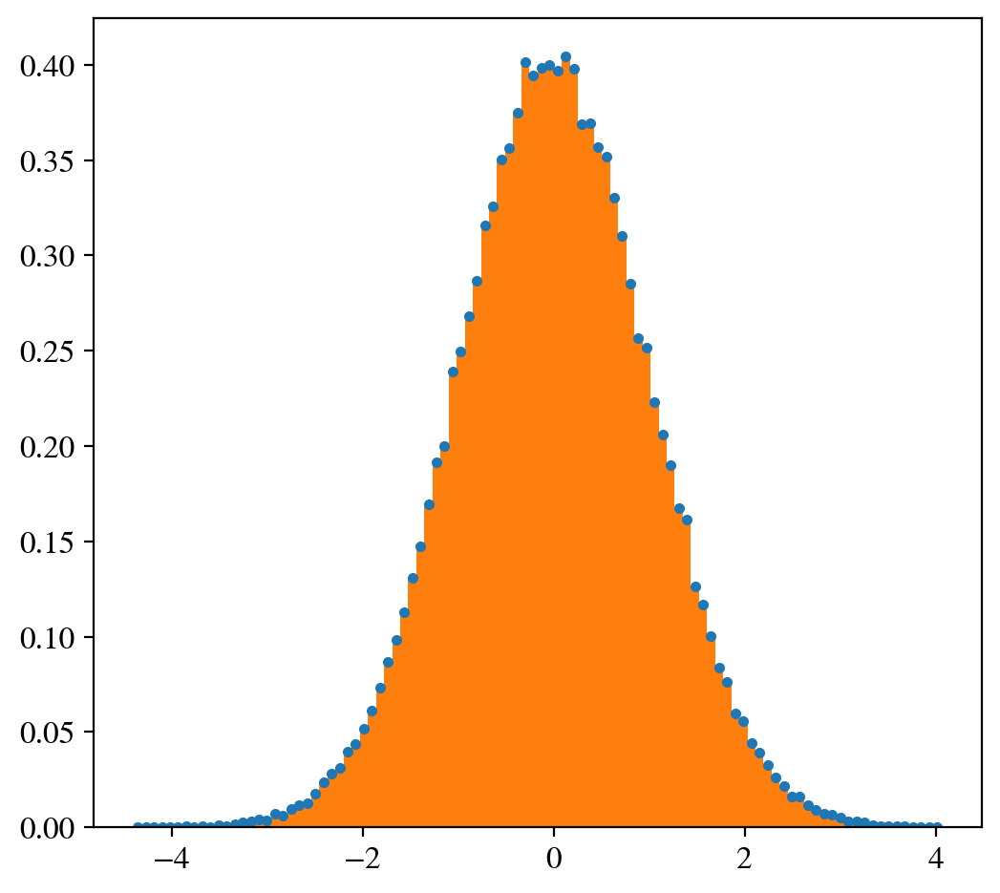

In [22]:
nbins = 100

tmod = np.random.normal(0, 1, 100000)

# hist_t, bins_t = np.histogram(tmod, nbins, density=True)
pdf_t, bins_t = np.histogram(tmod, nbins, density=True)
xbins_t = xBins(bins_t)

## normalize
# norm = np.sum(hist_t*xbins_t)
# norm = 1
# pdf_t = hist_t / norm

plt.plot(xbins_t, pdf_t, '.')
plt.hist(tmod, nbins, density=1)
print("")
# plt.yscale('log')
# plt.xscale('log')

In [23]:
np.unravel_index([0, 1, 2, 3], (2, 2))

(array([0, 0, 1, 1]), array([0, 1, 0, 1]))

In [24]:
uu = np.array([1,2,3,4,5])
uu[[0,0,0]], np.searchsorted(uu, [6,7,8])

(array([1, 1, 1]), array([5, 5, 5]))

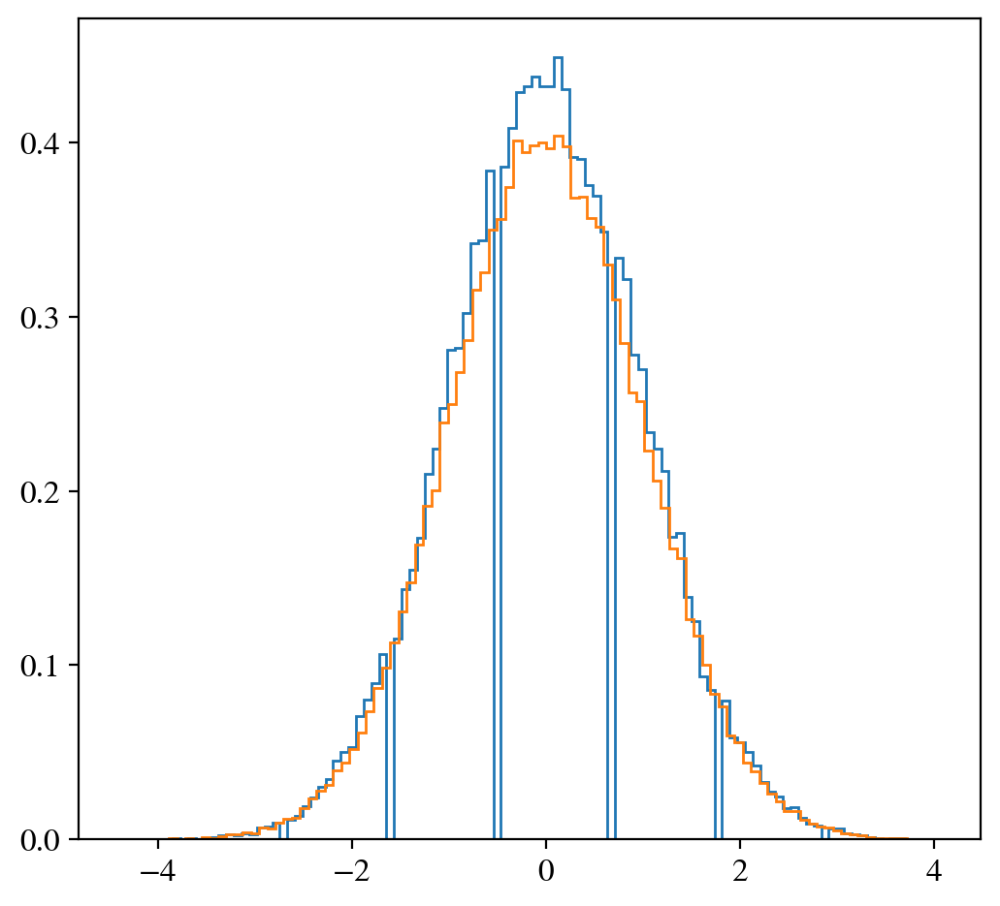

In [25]:
Nu = 100000
cdf_t = np.cumsum(pdf_t) / np.sum(pdf_t)

x_dist = invCDFGen(cdf_t, xbins_t, Nu)
plt.hist(x_dist, 100, histtype='step', density=1)
plt.hist(tmod, 100, histtype='step', density=1)
print("")

[]

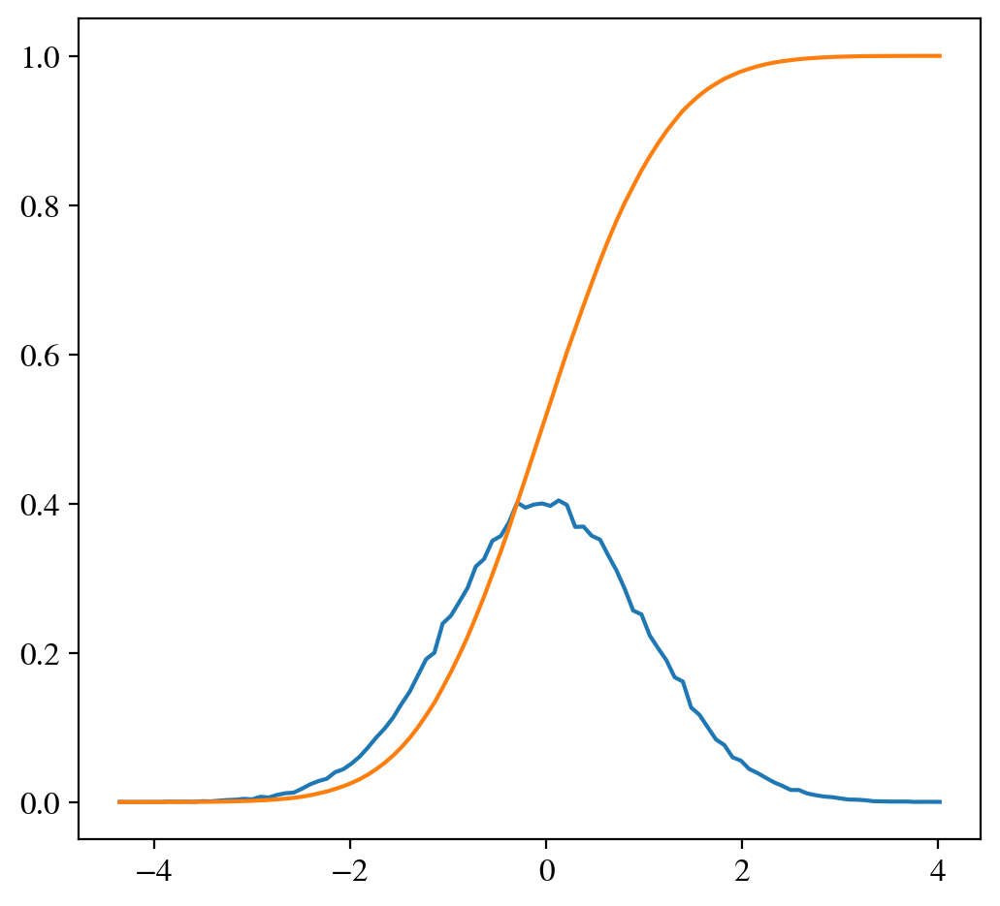

In [26]:
cdf = np.cumsum(pdf_t) / np.sum(pdf_t)

plt.plot(xbins_t, pdf_t)
plt.plot(xbins_t, cdf)
plt.plot()

In [27]:
### For a 1e6 ns total duration (1e3*1e3 n_bunches * bunch_DT)
### and 1.63e7 POTs / bunch
### nbins = 1e6 (1 bin per ns)
### nsamples = 1.63e10 (1.63e7*1e3 (POTs/bunch)*n_bunches)

nbins = int(1e6) 
nsamples = int(2*1e7)

tmod = frontcrv0.HitT[frontcrv0.HitT<=1e6]
print(len(tmod/1e3), len(frontcrv0.HitT/1e3))

pdf_t, xbins_t = getPDFfromDist(tmod, nbins)

160965 163669


In [28]:
t_gen = generateFromDist(tmod, nbins, nsamples)

pdf norm = 1.00e+00


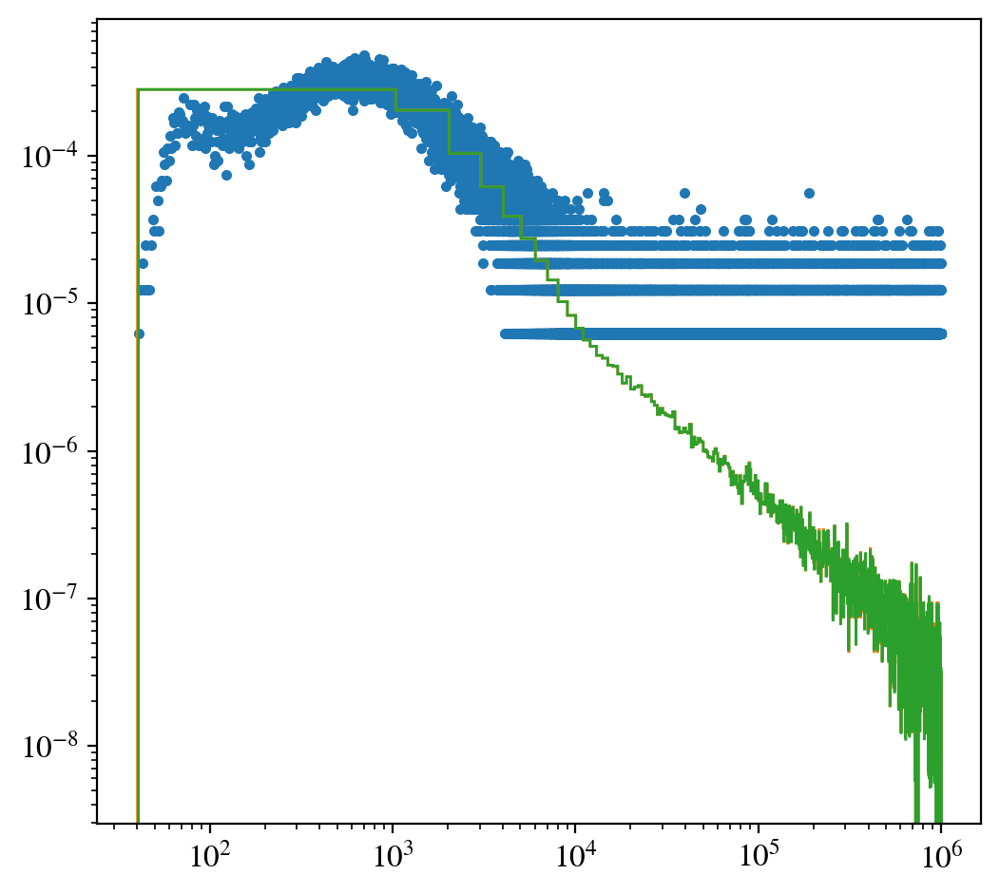

In [29]:

plt.plot(xbins_t, pdf_t, '.')
plt.hist(tmod, 1000, density=True, histtype='step')
plt.hist(t_gen, 1000, density=True, histtype='step')
plt.yscale('log')
# plt.xlim(0, 1e3)
plt.xscale('log')

In [30]:
nPOT = 99995000 
nPOTperBunch = int(1.63e7)
DT = 1316 ## ns, bunch interval
dT = 100 ## ns, pulse duration
nBunches = 1000

Tmax = int(nBunches*DT)
nHits = len(frontcrv0.HitT)
nHitsPerPOT = nHits/nPOT
nHitsPerBunch = int(nHitsPerPOT*nPOTperBunch)
print(nHits, nHitsPerPOT, nHitsPerBunch)

T_arr = np.linspace(0, Tmax-1, Tmax)
T_arr

163669 0.0016367718385919296 26679


array([0.000000e+00, 1.000000e+00, 2.000000e+00, ..., 1.315997e+06,
       1.315998e+06, 1.315999e+06])

In [31]:
u, v, w = np.array([1, 2, 3, 4]), np.array([4, 5, 6, 7]), np.array([7, 8, 9, 10])

h3d, bin3d = np.histogramdd([u, v, w], [10, 5, 5])
bin1, bin2, bin3 = bin3d

h3d.shape, bin1.shape

((10, 5, 5), (11,))

In [32]:
h2, bin1, bin2 = np.histogram2d(u, v, 10)

h2.shape, bin1.shape

((10, 10), (11,))

In [33]:
### For a 1e6 ns total duration (1e3*1e3 n_bunches * bunch_DT)
### and 1.63e7 POTs / bunch
### nbins = 1e6 (1 bin per ns)
### nsamples = 1.63e10 (1.63e7*1e3 (POTs/bunch)*n_bunches)

nbins = int(1e6) 
nsamples = int(nHitsPerBunch*nBunches)
print(nsamples)

tmod = frontcrv0.HitT[frontcrv0.HitT<=1e6]
print(len(tmod/1e3), len(frontcrv0.HitT/1e3))

pdf_t, xbins_t = getPDFfromDist(tmod, nbins)
t_gen = generateFromDist(tmod, nbins, nsamples)

26679000
160965 163669
pdf norm = 1.00e+00


In [34]:
# bunchT = np.array([np.linspace(ibunch*DT, ibunch*DT + dT, nHitsPerBunch) for ibunch in range(nBunches)])
bunchT = np.array([np.random.uniform(ibunch*DT, ibunch*DT + dT, nHitsPerBunch) for ibunch in range(nBunches)])
bunchT_flat = bunchT.flatten()

len(bunchT_flat), len(t_gen), bunchT_flat[:3]

(26679000, 26679000, array([68.69238306, 10.10101551, 66.73482258]))

In [35]:
### real time distribution (thit) over nBunches bunches
### = uniform distribution of POT t0 + custom distribution of thit-t0 

t_dist_real = bunchT_flat + t_gen

In [36]:
np.max(bunchT_flat)/1e6

1.3147839977468694

Text(0.5, 0, 'time (ns)')

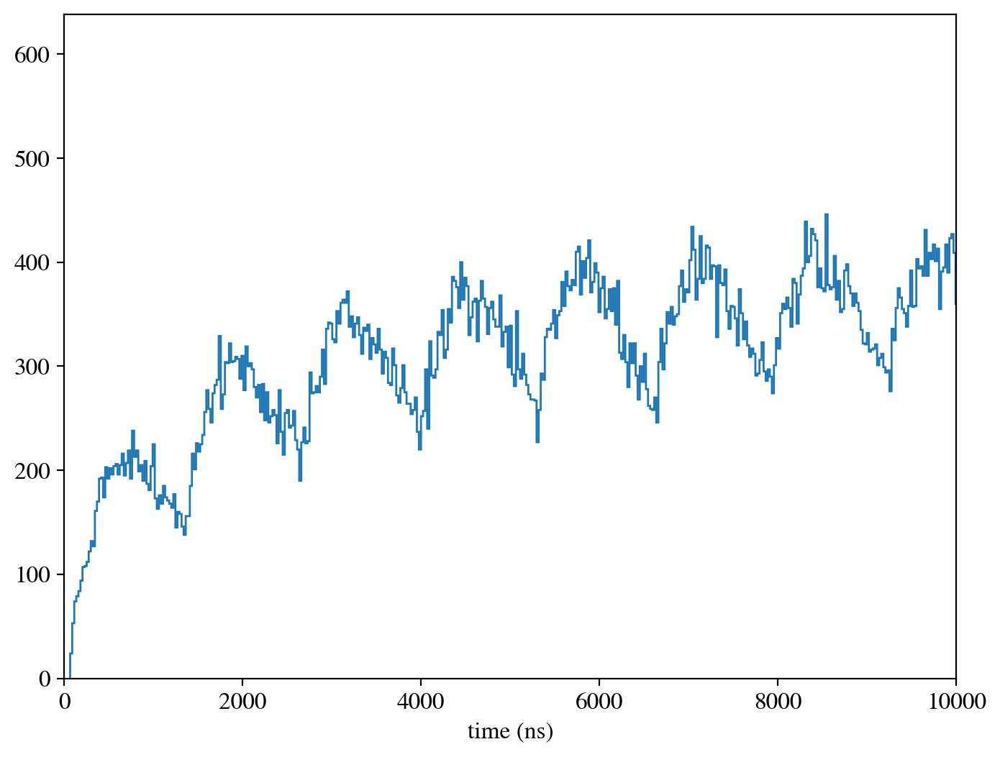

In [37]:
fig, ax = plt.subplots(figsize=(8, 6))
ax.hist(t_dist_real, int(1e5), histtype='step')
## show 3 bunches
# ax.set_xlim(0, int(3*DT))
ax.set_xlim(0, int(1e4))
ax.set_xlabel("time (ns)")

Text(0.5, 0, 'time (ns)')

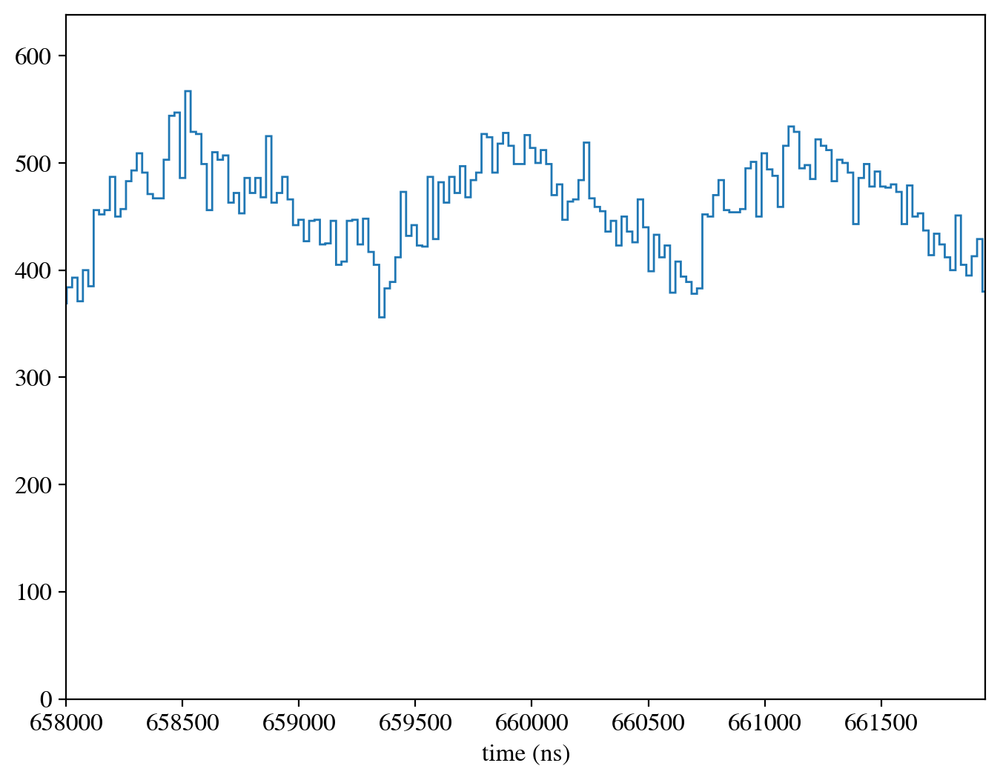

In [38]:
fig, ax = plt.subplots(figsize=(8, 6))
ax.hist(t_dist_real, int(1e5), histtype='step')
## show 3 bunches
# ax.set_xlim(0, int(3*DT))
ax.set_xlim(int(500*DT), int(503*DT))
ax.set_xlabel("time (ns)")

In [39]:
nbins = int(1e3)
# nsamples = int(1e5)
nsamples = int(nHitsPerBunch*nBunches)

xmod = frontcrv0.HitY[frontcrv0.HitT<=2e6]
ymod = frontcrv0.HitZ[frontcrv0.HitT<=2e6]

hist2d, xbins, ybins = getPDFfromDist_2D(xmod, ymod, nbins)
x_dist, y_dist = generateFromDist_2D(xmod, ymod, nbins, nsamples)

pdf norm = 6.18e-02


In [40]:
nHits/1e5

1.63669

In [167]:
nbins = int(1e4)
nsamples = int(1e6)
# nsamples = int(nHitsPerBunch*nBunches)

xmod = frontcrv0.HitY[frontcrv0.HitT<=2e6]
ymod = frontcrv0.HitZ[frontcrv0.HitT<=2e6]

hist2d, xbins, ybins = getPDFfromDist_2D(xmod, ymod, nbins)
x_dist, y_dist = generateFromDist_2D(xmod, ymod, nbins, nsamples)

pdf norm = 6.18e+00


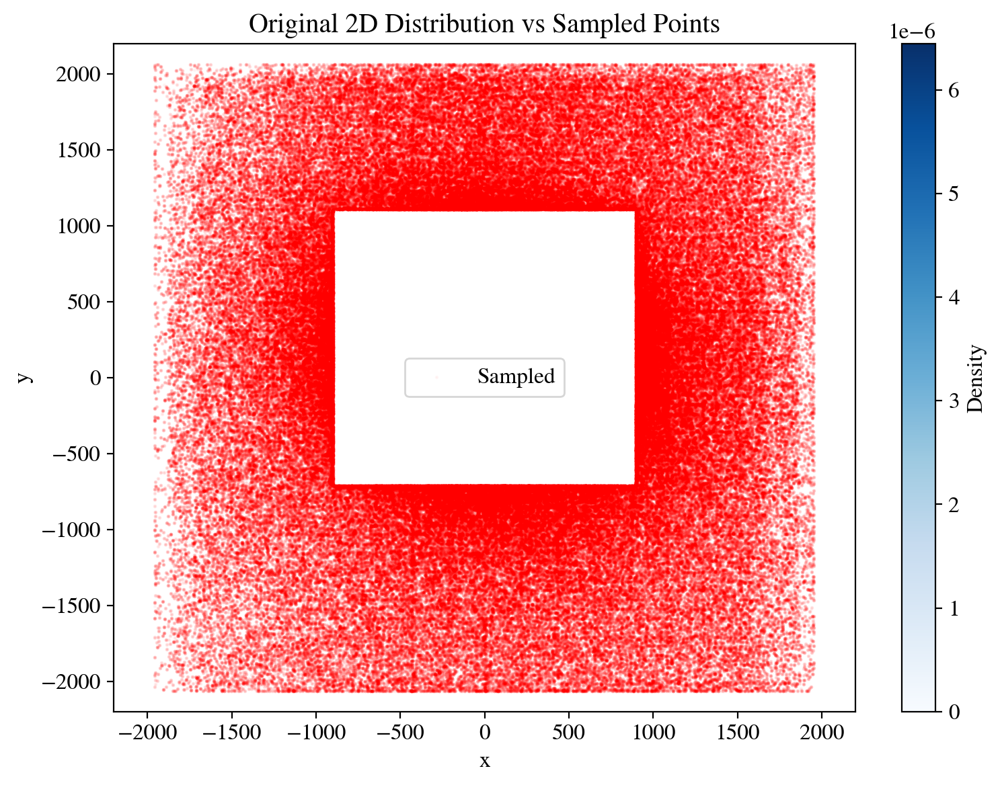

In [120]:
# Plot the results
fig, ax = plt.subplots(figsize=(8, 6))
# Plot original histogram as a heatmap
# mesh = ax.hist2d(xmod, ymod, bins=nbins, cmap='Blues', density=True, alpha=1)
# Overlay sampled points
# ax.scatter(xmod, ymod, s=1, color='red', alpha=0.03, label='Sampled')
ax.scatter(x_dist, y_dist, s=1, color='red', alpha=0.03, label='Sampled')

# Customize the plot
ax.set_title('Original 2D Distribution vs Sampled Points')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.legend()
plt.colorbar(mesh[3], ax=ax, label='Density')
# plt.grid(True)
plt.xlim(-2200, 2200)
plt.ylim(-2200, 2200)
plt.tight_layout()
plt.show()

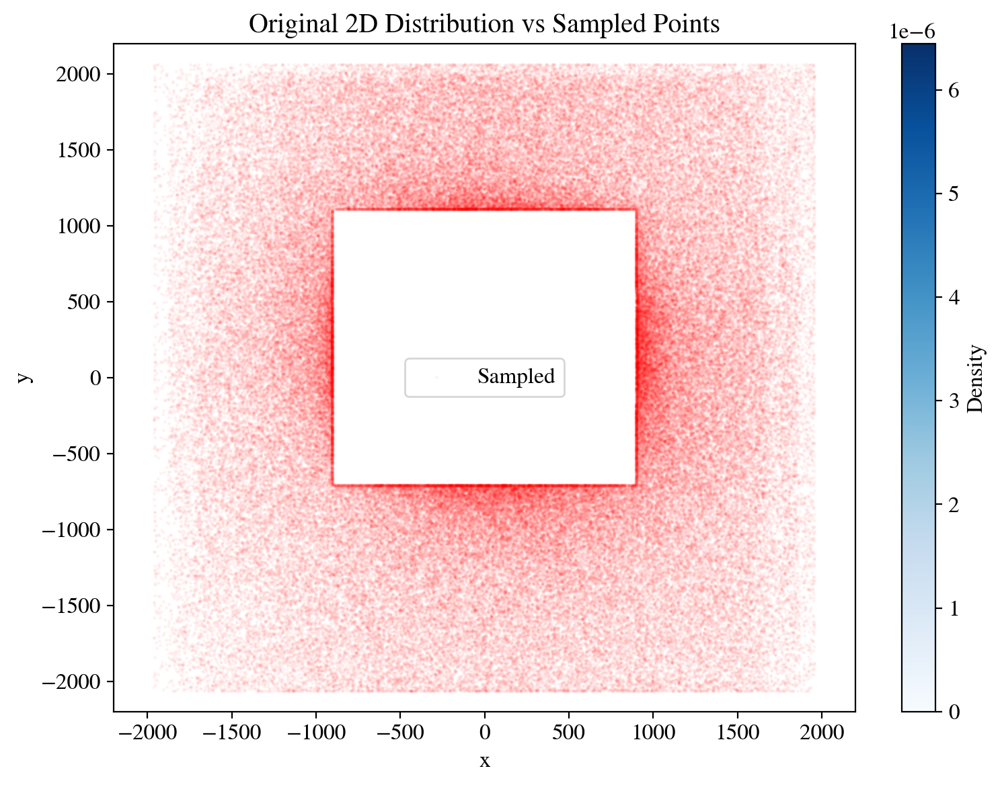

In [121]:
# Plot the results
fig, ax = plt.subplots(figsize=(8, 6))
# Plot original histogram as a heatmap
# mesh = ax.hist2d(xmod, ymod, bins=nbins, cmap='Blues', density=True, alpha=1)
# Overlay sampled points
ax.scatter(xmod, ymod, s=1, color='red', alpha=0.03, label='Sampled')
# ax.scatter(x_dist, y_dist, s=1, color='red', alpha=0.03, label='Sampled')

# Customize the plot
ax.set_title('Original 2D Distribution vs Sampled Points')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.legend()
plt.colorbar(mesh[3], ax=ax, label='Density')
# plt.grid(True)
plt.xlim(-2200, 2200)
plt.ylim(-2200, 2200)
plt.tight_layout()
plt.show()

In [122]:
len(xmod), len(x_dist)

(163051, 1000000)

In [43]:
max(abs(x_dist))

1959.5592422942318

In [44]:
# # nbinst = 1000
# # nbinst = int(1e5)
# nbinsxy = 1000
# nsamples = 10000
# # nsamples = int(nHitsPerBunch*nBunches)

# tmod = frontcrv0.HitT[frontcrv0.HitT<=2e6]
# xmod = frontcrv0.HitY[frontcrv0.HitT<=2e6]
# ymod = frontcrv0.HitZ[frontcrv0.HitT<=2e6]

# print(tmod.shape, xmod.shape, ymod.shape)
# hist3d, tbins, xbins, ybins = getPDFfromDist_3D(tmod, xmod, ymod, nbinst, nbinsxy)
# t_dist, x_dist, y_dist = generateFromDist_3D(tmod, xmod, ymod, nbinst, nbinsxy, nsamples)

# # Plot the results
# fig, ax = plt.subplots(figsize=(8, 6))
# # Plot original histogram as a heatmap
# mesh = ax.hist2d(xmod, ymod, bins=nbinsxy, cmap='Blues', density=True, alpha=0.5)
# # Overlay sampled points
# ax.scatter(x_dist, y_dist, s=1, color='red', alpha=0.1, label='Sampled')

# # Customize the plot
# ax.set_title('Original 2D Distribution vs Sampled Points')
# ax.set_xlabel('x')
# ax.set_ylabel('y')
# ax.legend()
# plt.colorbar(mesh[3], ax=ax, label='Density')
# # plt.grid(True)
# plt.tight_layout()
# plt.show()

In [45]:
# np.sum(pdf_t), np.sum(pdf_t*xBins(bins_t))

In [46]:
cdf_t = np.cumsum(pdf_t) / np.sum(pdf_t)

In [158]:
frontcrv1b = CRVHitMap("../Root_outputs/CRVAnalysis.root")

In [107]:
# moduleL = 3000
# modulel = 1240
moduleL = 2740
modulel = 4240-moduleL
moduleL, modulel

(2740, 1500)

In [108]:
nstrips = 48*2 ## n_strips/module
side_length = moduleL+modulel
side_length//2, nstrips

(2120, 96)

In [168]:
## scaled nHits for redistribution 
nHits_b = int(1e6)
nPOT_b = nHits_b / nHitsPerPOT

nHits/1e6, len(x_dist)/1e6, nPOT/1e6, nPOT_b/1e6

(0.163669, 1.0, 99.995, 610.95870323641)

pdf norm = 1.15e+05



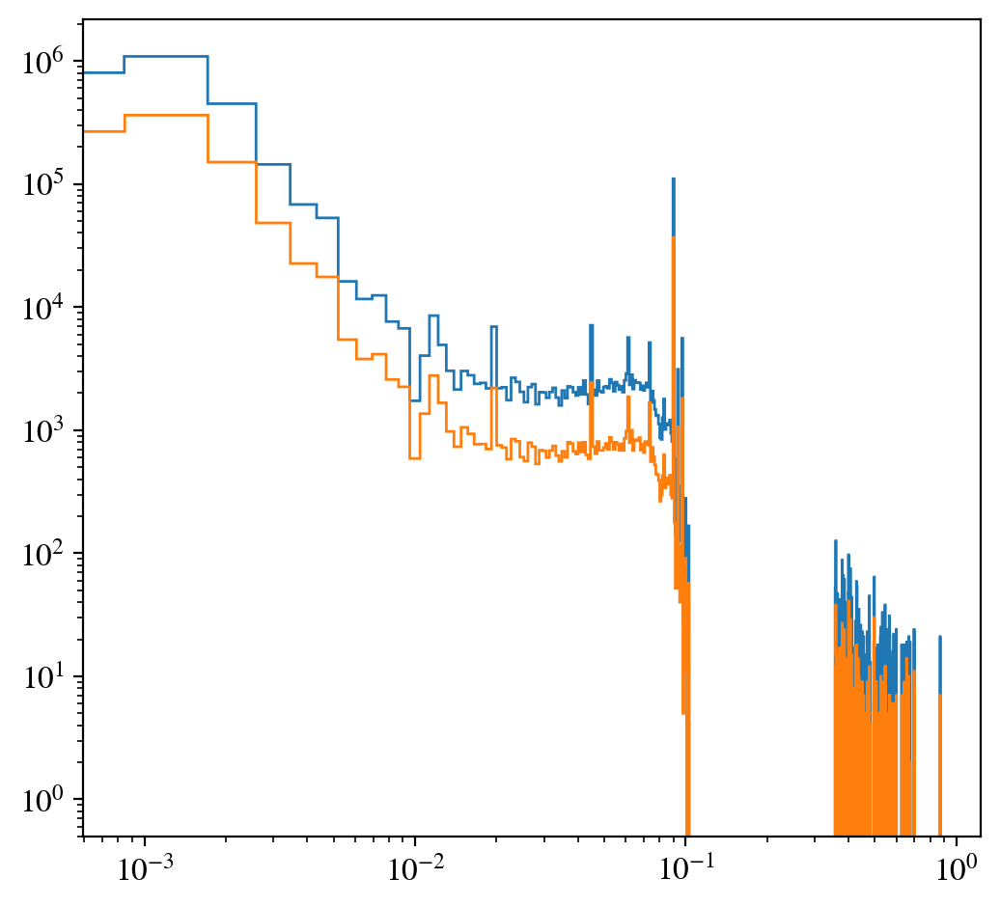

In [169]:
weights_dist = generateFromDist(frontcrv1b.RPCweights, int(1e5), int(1e6))

plt.hist(frontcrv1b.RPCweights, bins=1000, histtype='step')
plt.hist(weights_dist, bins=1000, histtype='step')
plt.xscale('log')
plt.yscale('log')
print("")

In [170]:
### use generated YZ hits and generated weights instead, and scale number of POTs.
frontcrv1b.HitY = x_dist
frontcrv1b.HitZ = y_dist
frontcrv1b.RPCweights = weights_dist
frontcrv1b.nPOT = nPOT_b
frontcrv1b.nhits = nHits_b

In [192]:
frontcrv1b.getGeometry(nstrips=96, xmin=-2120, xmax=2120, ymin=-2120, ymax=2120, L=moduleL, l=modulel, geo_type='rectangular strips 1')
frontcrv1b.getHitsPerChannel()

Rectangular module dimensions: L = 2740, l = 1500, D = 4240


In [193]:
frontcrv1b.hitRateFactor

4091.9295964798243

In [194]:
HitRateArr = []
for i in range(frontcrv1b.geometry.nstrips):
    HitRateArr.append(frontcrv1b.module1Hits[i])
    HitRateArr.append(frontcrv1b.module2Hits[i])
    HitRateArr.append(frontcrv1b.module3Hits[i])
    HitRateArr.append(frontcrv1b.module4Hits[i])
AvgHitRatePerStrip1b = np.mean(HitRateArr)
AvgHitRatePerStrip1b/1000

93.14518547360153

AvgHitRatePerStrip = 93.15 kHz
max_hit_rate = 214.68 kHz/strip


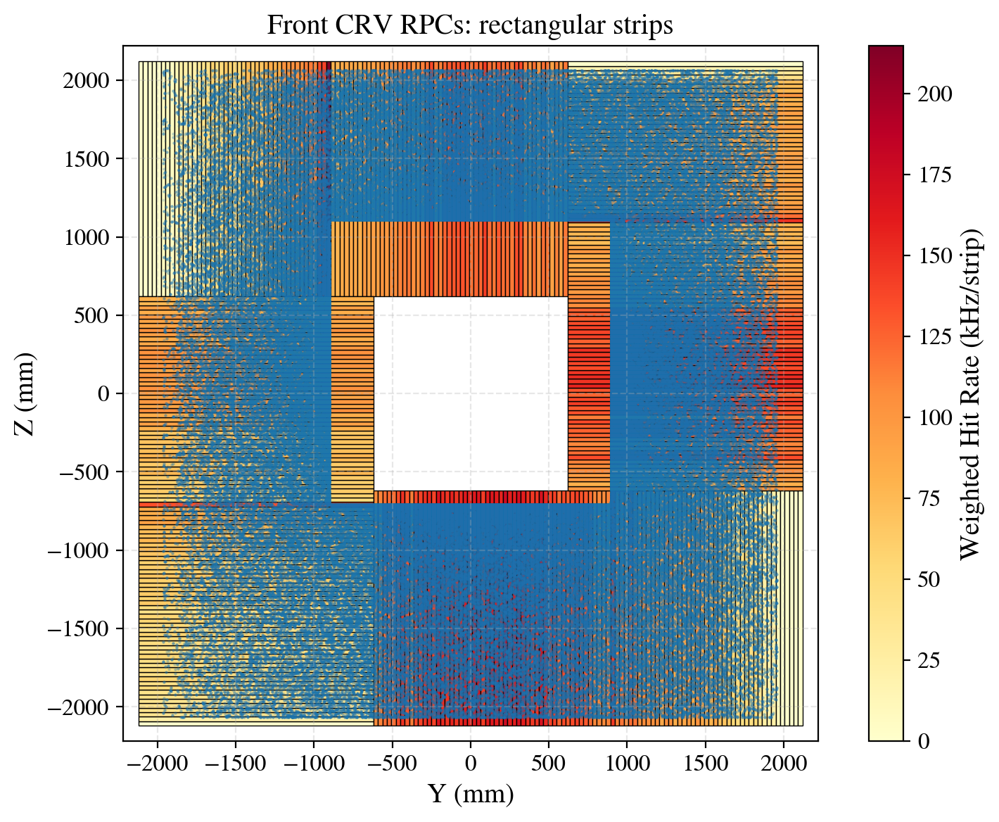

In [195]:
print("AvgHitRatePerStrip = {:.2f} kHz".format(AvgHitRatePerStrip1b/1000))
plot_strip_hitmap(frontcrv1b, plotHits=True)

In [183]:
frontcrv1 = CRVHitMap("../Root_outputs/CRVAnalysis.root")

In [184]:
frontcrv1.getGeometry(nstrips=96, xmin=-2120, xmax=2120, ymin=-2120, ymax=2120, L=moduleL, l=modulel, geo_type='rectangular strips 1')
frontcrv1.getHitsPerChannel()

Rectangular module dimensions: L = 2740, l = 1500, D = 4240


In [185]:
HitRateArr = []
for i in range(frontcrv1.geometry.nstrips):
    HitRateArr.append(frontcrv1.module1Hits[i])
    HitRateArr.append(frontcrv1.module2Hits[i])
    HitRateArr.append(frontcrv1.module3Hits[i])
    HitRateArr.append(frontcrv1.module4Hits[i])
AvgHitRatePerStrip1 = np.mean(HitRateArr)
AvgHitRatePerStrip1/1000

93.14396670898999

In [186]:
frontcrv1.geometry.L, frontcrv1.hitRateFactor

(2740, 25001.250062503124)

AvgHitRatePerStrip = 93.14 kHz
max_hit_rate = 205.71 kHz/strip


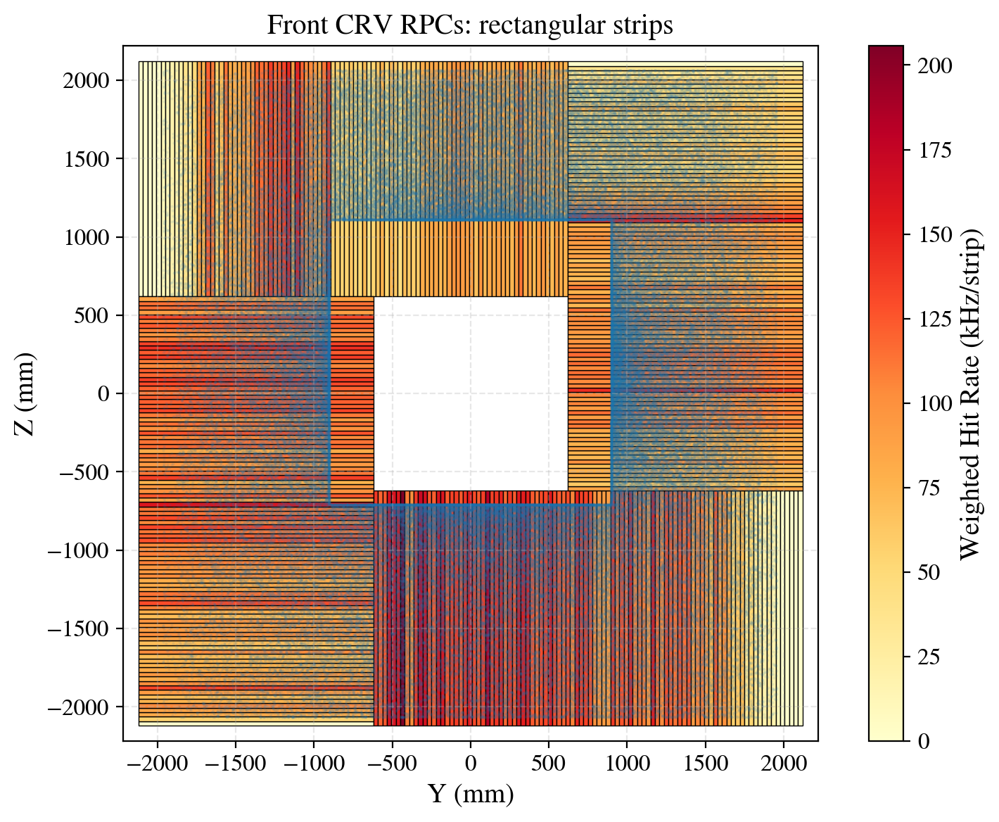

In [187]:
print("AvgHitRatePerStrip = {:.2f} kHz".format(AvgHitRatePerStrip1/1000))
plot_strip_hitmap(frontcrv1, plotHits=True)

In [175]:
frontcrv2 = CRVHitMap("../Root_outputs/CRVAnalysis.root")

In [176]:
frontcrv2.getGeometry(nstrips=96, xmin=-2120, xmax=2120, ymin=-2120, ymax=2120, L=moduleL, l=modulel, geo_type='rectangular strips 2')
frontcrv2.getHitsPerChannel()

Rectangular module dimensions: L = 2740, l = 1500, D = 4240


In [177]:
HitRateArr = []
for i in range(frontcrv2.geometry.nstrips):
    HitRateArr.append(frontcrv2.module1Hits[i])
    HitRateArr.append(frontcrv2.module2Hits[i])
    HitRateArr.append(frontcrv2.module3Hits[i])
    HitRateArr.append(frontcrv2.module4Hits[i])
AvgHitRatePerStrip2 = np.mean(HitRateArr)
AvgHitRatePerStrip2/1000

93.14396670899

AvgHitRatePerStrip = 93.14 kHz
max_hit_rate = 425.99 kHz/strip


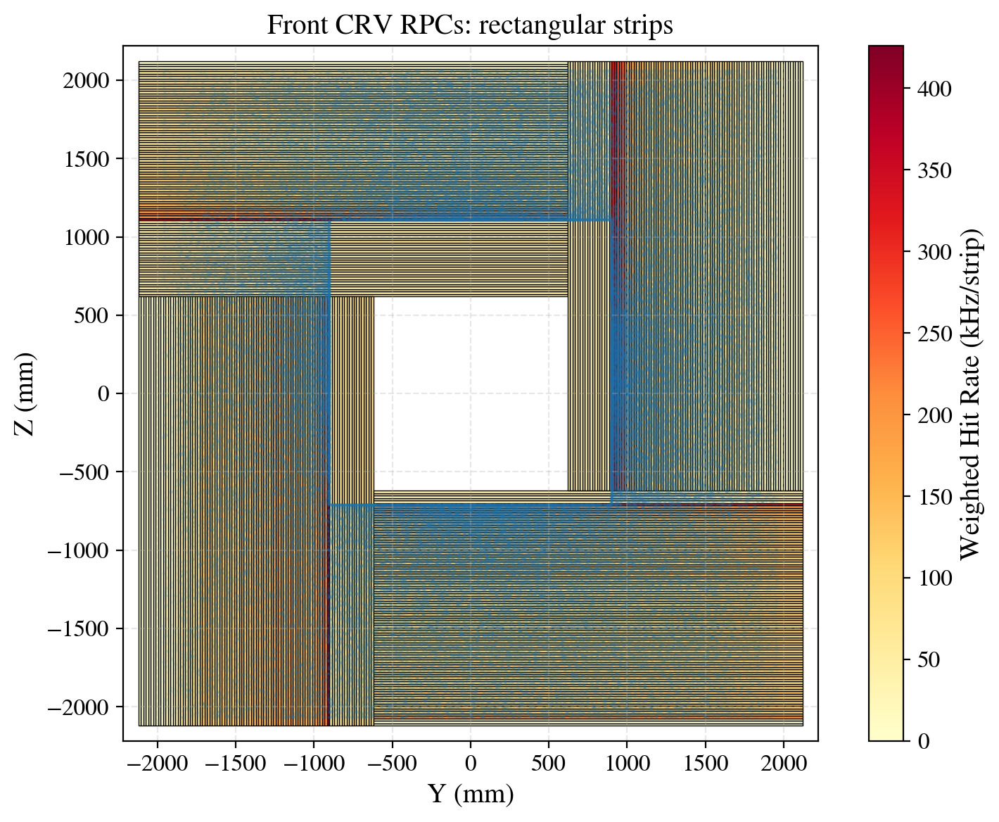

In [178]:
print("AvgHitRatePerStrip = {:.2f} kHz".format(AvgHitRatePerStrip2/1000))
plot_strip_hitmap(frontcrv2, plotHits=True)

In [59]:
hole_side = side_length - 2*modulel ## side length of hole
moduleH = (side_length - hole_side)//2 ## trapezoid height in trapezoidal geo

hole_side, moduleH

(1240, 1500)

In [60]:
moduleL+modulel, moduleL-modulel

(4240, 1240)

In [61]:
frontcrv3 = CRVHitMap("../Root_outputs/CRVAnalysis.root")

In [62]:
frontcrv3.getGeometry(nstrips=96, xmin=-2120, xmax=2120, ymin=-2120, ymax=2120, L=1500, geo_type='trapezoidal strips')
frontcrv3.getHitsPerChannel()

Trapezoidal module dimensions: L = 4240, l = 1240, H = 1500


KeyboardInterrupt: 

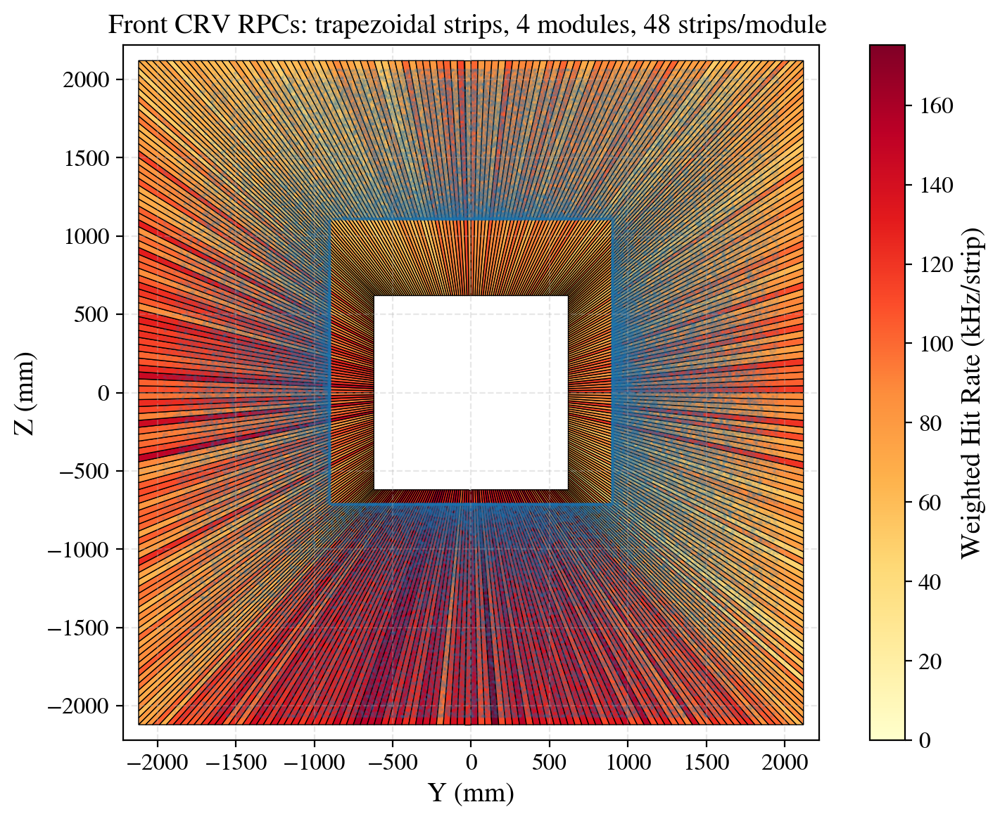

In [ ]:
plot_trapezoidal_strip_hitmap(frontcrv3, plotHits=True)

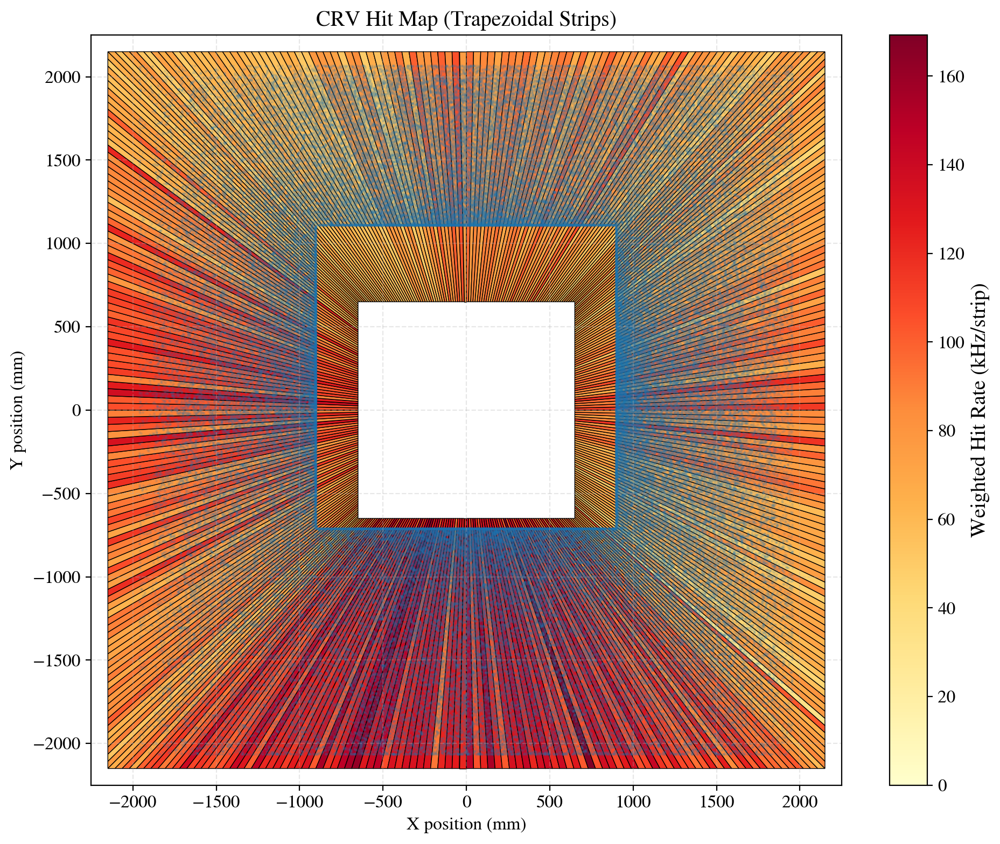

In [ ]:
plot_trapezoidal_strip_hitmap(frontcrv1, plotHits=True)

In [ ]:
np.stack([[1,2,3], [4,5,6]], axis=1)

array([[1, 4],
       [2, 5],
       [3, 6]])

In [ ]:
frontcrv2 = CRVHitMap("../Root_outputs/CRVAnalysis.root")

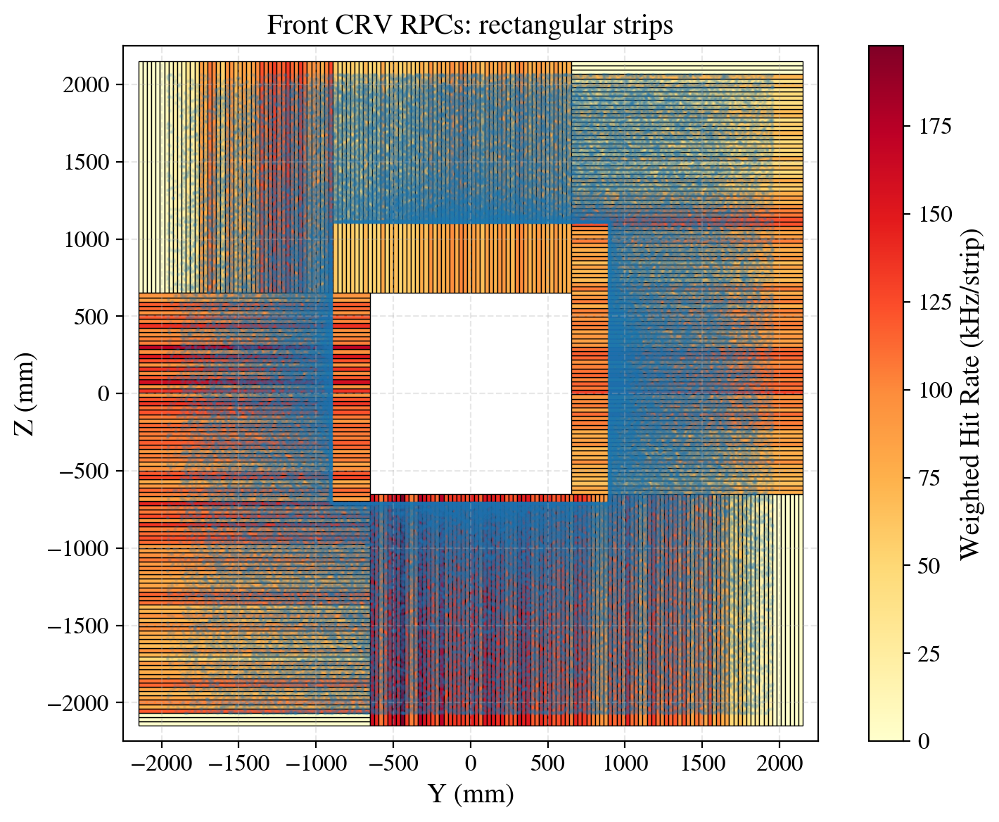

In [ ]:
frontcrv2.getGeometry(nstrips=100, geo_type='rectangular strips 1')
frontcrv2.getHitsPerChannel()
plot_strip_hitmap(frontcrv2, plotHits=True)

In [ ]:
frontcrv3 = CRVHitMap("../Root_outputs/CRVAnalysis.root")

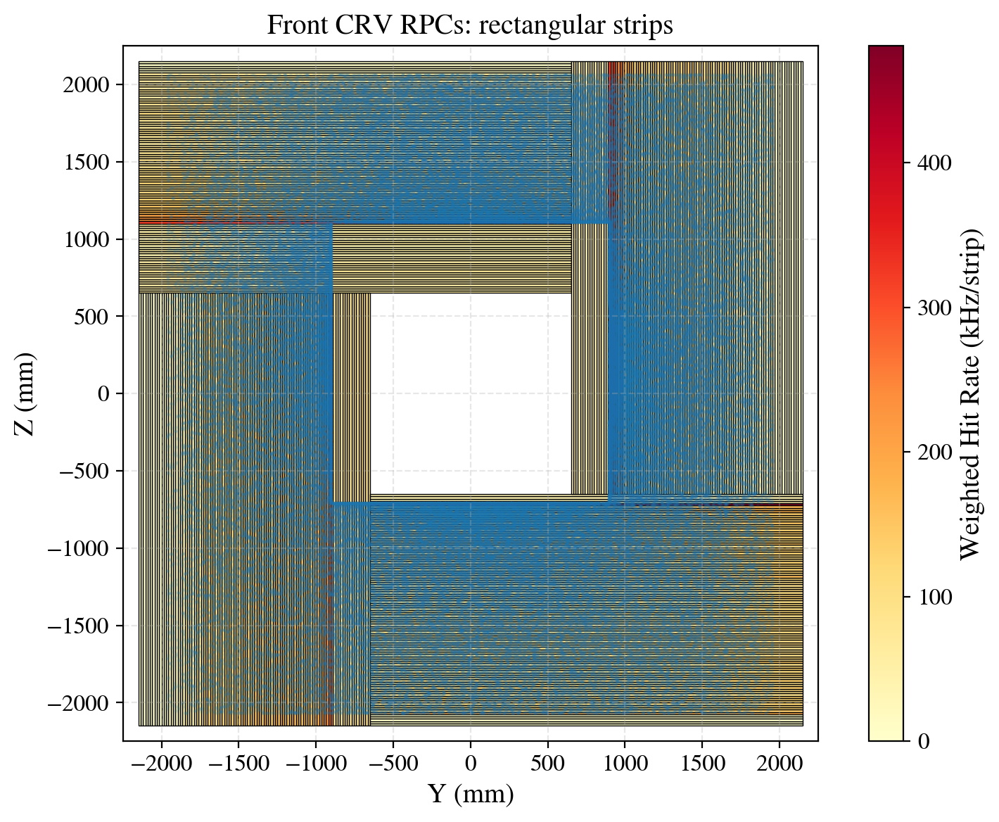

In [ ]:
frontcrv3.getGeometry(nstrips=100, geo_type='rectangular strips 2')
frontcrv3.getHitsPerChannel()
plot_strip_hitmap(frontcrv3, plotHits=True)

In [ ]:
def debug_plot_geometry_only(geometry, figsize=(10, 8)):
    import matplotlib.pyplot as plt
    from matplotlib.patches import Polygon as MplPolygon

    fig, ax = plt.subplots(figsize=figsize)
    for i, poly in geometry.allStrips.items():
        coords = np.array(poly.exterior.coords)
        patch = MplPolygon(coords, closed=True, facecolor='lightgray', edgecolor='black', linewidth=1)
        ax.add_patch(patch)

        # Add strip index
        centroid = poly.centroid
        ax.text(centroid.x, centroid.y, str(i), ha='center', va='center', fontsize=6)

    ax.set_aspect('equal')
    ax.set_xlabel("X (mm)")
    ax.set_ylabel("Y (mm)")
    ax.set_title("DEBUG: Trapezoid Geometry Only")
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()
    plt.show()


In [ ]:
debug_plot_geometry_only(frontcrv1.geometry)

/var/folders/gn/6k22_3_d37b4pwtr1ffv1fjr0000gn/T/ipykernel_40141/3469615731.py:20: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


ValueError: Image size of 3994474x3994473 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 2000x1600 with 1 Axes>

In [ ]:
frontcrv1.hitRateFactor, frontcrv1.nhits

(25001.250062503124, 163669)

In [ ]:
frontcrv1.stripHits

{0: 635747.7680505612,
 1: 624087.5083586515,
 2: 622074.4764146878,
 3: 688883.067718643,
 4: 871936.7312849533,
 5: 858782.7616144458,
 6: 802036.760013138,
 7: 815213.8644944476,
 8: 739178.2381586055,
 9: 667139.177497612,
 10: 786399.2418650051,
 11: 802760.3176779705,
 12: 869642.0878830194,
 13: 944741.6728341397,
 14: 1048286.6474932983,
 15: 1116698.2000928626,
 16: 1037307.5976626596,
 17: 927345.796865796,
 18: 820936.0988997653,
 19: 683139.504436909,
 20: 937205.6946680878,
 21: 1170352.9375850384,
 22: 1271570.2024733908,
 23: 1365578.1297066566,
 24: 1253837.6355026003,
 25: 1287370.7305104786,
 26: 1291118.9123238502,
 27: 1222343.1003199646,
 28: 1073609.1470949412,
 29: 919932.4102452055,
 30: 736345.8789616718,
 31: 623446.8862314994,
 32: 642541.421722037,
 33: 770450.2280813645,
 34: 867889.6251692205,
 35: 955370.1633476138,
 36: 843743.3333668229,
 37: 796208.0727611659,
 38: 671299.669557627,
 39: 704731.5173056722}

In [ ]:
stripPitch = 0.1*frontcrv1.geometry.pitch ## in cm
stripSurface = stripPitch * 0.1*frontcrv1.geometry.l ## in cm2
# stripSurface = stripPitch * 0.1*frontcrv1.geometry.L ## in cm2

stripPitch, stripSurface

(2.8000000000000003, 420.00000000000006)

In [ ]:
module1Hits_arr = np.array([ d for i,d in frontcrv1.module1Hits.items()])

np.mean(module1Hits_arr), np.mean(module1Hits_arr)/stripSurface

(72794.69787874488, 173.32070923510682)

In [ ]:
frontcrv1.module1Hits

{0: 0,
 1: 0,
 2: 0,
 3: 0,
 4: 0,
 5: 0,
 6: 11407.491474747552,
 7: 7851.44219178146,
 8: 19905.00178441778,
 9: 13712.122603446556,
 10: 19758.60900160878,
 11: 37384.49119605677,
 12: 22692.055877475726,
 13: 39211.676995176334,
 14: 85918.05262870323,
 15: 75233.9158309577,
 16: 108552.17893743287,
 17: 100242.30569916203,
 18: 69268.1217446232,
 19: 55504.74905538695,
 20: 94735.95300868653,
 21: 92979.58306670512,
 22: 70620.42406772572,
 23: 79126.41229417601,
 24: 86051.50620730624,
 25: 76067.98018532345,
 26: 85264.11102091803,
 27: 99470.50806609492,
 28: 123030.22627323157,
 29: 107258.25546835775,
 30: 117867.13652733387,
 31: 130321.50158886868,
 32: 114285.02148154152,
 33: 117874.20058908293,
 34: 133119.97663890405,
 35: 114257.42347633262,
 36: 101279.21172946412,
 37: 131971.82688393828,
 38: 112664.93893663047,
 39: 91699.93397219278,
 40: 96499.87673771109,
 41: 92873.05165685958,
 42: 75131.01031579163,
 43: 104260.3593819115,
 44: 128671.76764366146,
 45: 59650.

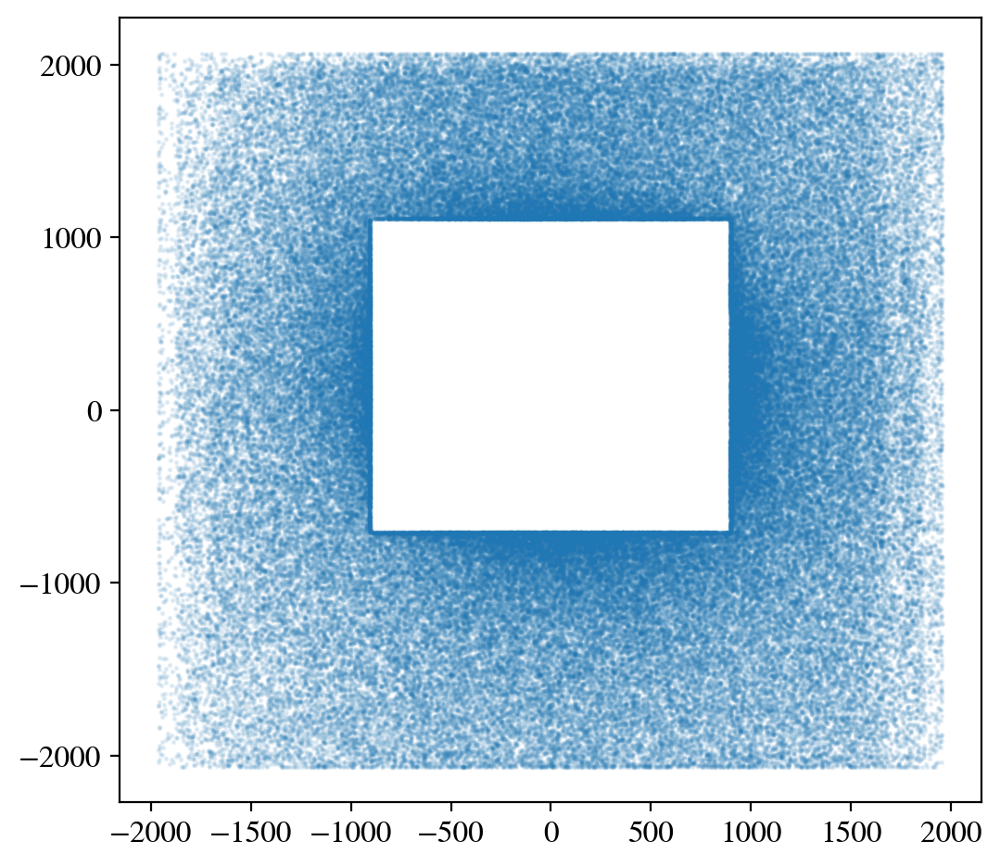

In [ ]:
crvmap = frontcrv1

plt.scatter(crvmap.HitY, crvmap.HitZ, s=1, alpha=0.1)

In [ ]:
2*2150-2800, 2*2150-2*1500

(1500, 1300)

In [ ]:
import shapely
from matplotlib.patches import Polygon as MplPolygon
import matplotlib.colors as mcolors
from shapely.geometry import Polygon

### TENTATIVE
class ModuleGeoTrapezoidal:
    def __init__(self, xmin=-2150, xmax=2150, ymin=-2150, ymax=2150, H=1500):
        self.nstrips = nstrips
        self.Xmax = xmax
        self.Xmin = xmin
        self.Ymax = ymax
        self.Ymin = ymin
        self.L = (self.Xmax-self.Xmin) ## outer radius trapezoid length
        self.H = H ## trapezoid height
        self.l = self.L - 2*self.H ## inner radius trapezoid length
        self.outPitch = self.L/self.nstrips ## outer pitch of trapezoid module
        self.inPitch = self.l/self.nstrips ## inner pitch of trapezoid module
        self.makeStrips()

    def makeStrips(self):

        dL = self.outPitch 
        dl = self.inPitch
        nstrips = self.nstrips

        self.module1strips = {}  # Dict of polygons
        self.module2strips = {}  # Dict of polygons
        self.module3strips = {}  # Dict of polygons
        self.module4strips = {}  # Dict of polygons

        ### module 1
        for i in range(nstrips):
            y0 = self.Ymax - self.H
            y1 = self.Ymax
            x0 = self.Xmin + self.H + i*dl
            x1 = self.Xmin + i*dL
            x2 = self.Xmin + self.H + (i+1)*dl
            x3 = self.Xmin + (i+1)*dL

            # Trapezoid corners (bottom wider than top)
            poly = Polygon([
                (x1, y1),  # top left
                (x3, y1),  # top right
                (x2, y0),  # bottom right
                (x0, y0)   # bottom left
            ])
            self.module1strips[i] = poly

        ### module 2
        for i in range(nstrips):
            x0 = self.Xmin + self.H
            x1 = self.Xmin 
            y0 = self.Ymin + self.H + i*dl
            y1 = self.Ymin + i*dL
            y2 = self.Ymin + self.H + (i+1)*dl
            y3 = self.Ymin + (i+1)*dL

            # Trapezoid corners (bottom wider than top)
            poly = Polygon([
                (x1, y3),  # top left
                (x0, y2),  # top right
                (x0, y0),  # bottom right
                (x1, y1)   # bottom left
            ])
            self.module2strips[i+nstrips] = poly

        ### module 3
        for i in range(nstrips):
            y0 = self.Ymin + self.H
            y1 = self.Ymin
            x0 = self.Xmin + self.H + i*dl
            x1 = self.Xmin + i*dL
            x2 = self.Xmin + self.H + (i+1)*dl
            x3 = self.Xmin + (i+1)*dL

            # Trapezoid corners (bottom wider than top)
            poly = Polygon([
                (x0, y0),  # top left
                (x2, y0),  # top right
                (x3, y1),  # bottom right
                (x1, y1)   # bottom left
            ])
            self.module3strips[i+2*nstrips] = poly

        ### module 4
        for i in range(nstrips):
            x0 = self.Xmax - self.H
            x1 = self.Xmax
            y0 = self.Ymin + self.H + i*dl
            y1 = self.Ymin + i*dL
            y2 = self.Ymin + self.H + (i+1)*dl
            y3 = self.Ymin + (i+1)*dL

            # Trapezoid corners (bottom wider than top)
            poly = Polygon([
                (x0, y2),  # top left
                (x1, y3),  # top right
                (x1, y1),  # bottom right
                (x0, y0)   # bottom left
            ])
            self.module4strips[i+3*nstrips] = poly
        
        self.allStrips = self.module1strips | self.module2strips | self.module3strips | self.module4strips


In [ ]:
trape = ModuleGeoTrapezoidal()

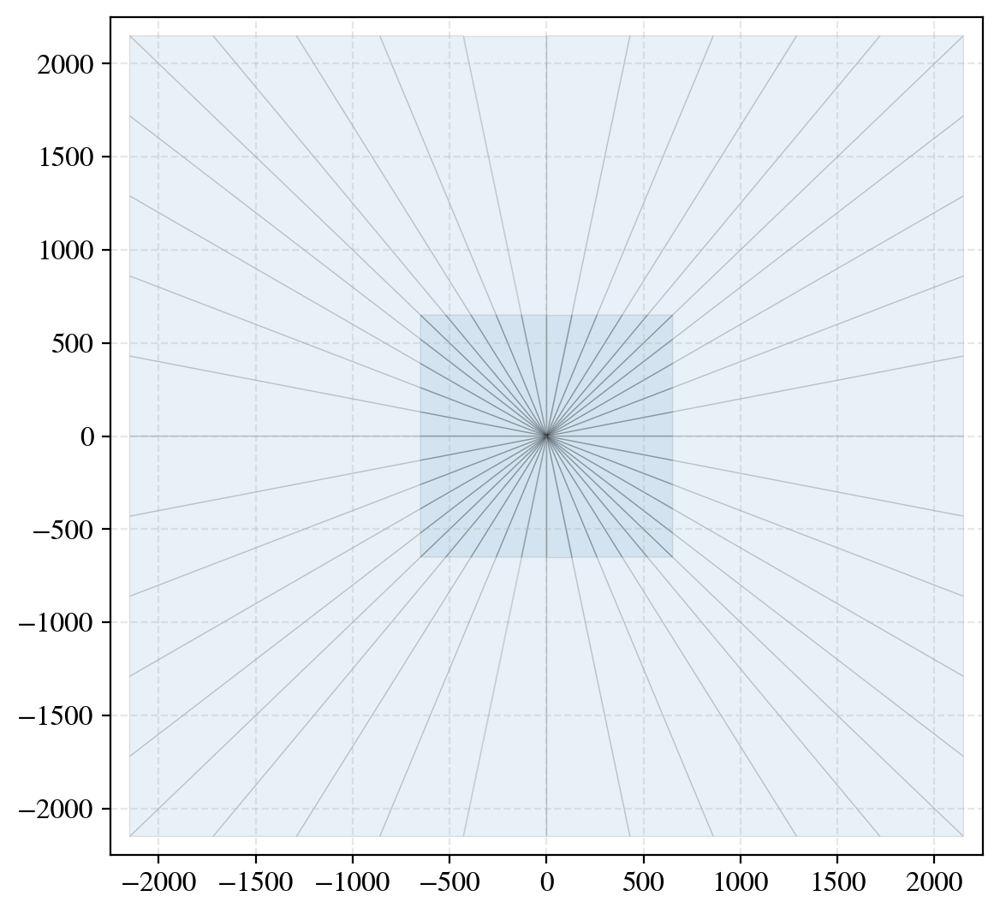

In [ ]:
fig, ax = plt.subplots()

strips = frontcrv1.geometry.allStrips

for i, poly in strips.items():
    # val = hits.get(i, 0)
    # color = cmap(norm(val))
    coords = np.array(poly.exterior.coords)
    patch = MplPolygon(coords, closed=True, facecolor='tab:blue',
                        edgecolor='black', linewidth=0.5, alpha=0.1)
    ax.add_patch(patch)

# Adjust limits to fit all polygons
all_x = [x for poly in strips.values() for x, _ in poly.exterior.coords]
all_y = [y for poly in strips.values() for _, y in poly.exterior.coords]
ax.set_xlim(min(all_x) - 100, max(all_x) + 100)
ax.set_ylim(min(all_y) - 100, max(all_y) + 100)

# # Add colorbar
# sm = plt.cm.ScalarMappable(norm=norm, cmap=cmap)
# cbar = plt.colorbar(sm, ax=ax)
# cbar.set_label("Weighted Hit Count", fontsize=12)

plt.grid(True, linestyle='--', alpha=0.3)
plt.tight_layout()
plt.show()

In [ ]:
frontcrv1.module1Hits, frontcrv1.module2Hits, frontcrv1.module3Hits, frontcrv1.module4Hits

({0: 0,
  1: 0,
  2: 0,
  3: 0,
  4: 0,
  5: 0,
  6: 11407.491474747552,
  7: 7851.44219178146,
  8: 19905.00178441778,
  9: 13712.122603446556,
  10: 19758.60900160878,
  11: 37384.49119605677,
  12: 22692.055877475726,
  13: 39211.676995176334,
  14: 85918.05262870323,
  15: 75233.9158309577,
  16: 108552.17893743287,
  17: 100242.30569916203,
  18: 69268.1217446232,
  19: 55504.74905538695,
  20: 94735.95300868653,
  21: 92979.58306670512,
  22: 70620.42406772572,
  23: 79126.41229417601,
  24: 86051.50620730624,
  25: 76067.98018532345,
  26: 85264.11102091803,
  27: 99470.50806609492,
  28: 123030.22627323157,
  29: 107258.25546835775,
  30: 117867.13652733387,
  31: 130321.50158886868,
  32: 114285.02148154152,
  33: 117874.20058908293,
  34: 133119.97663890405,
  35: 114257.42347633262,
  36: 101279.21172946412,
  37: 131971.82688393828,
  38: 112664.93893663047,
  39: 91699.93397219278,
  40: 96499.87673771109,
  41: 92873.05165685958,
  42: 75131.01031579163,
  43: 104260.3593